<a href="https://colab.research.google.com/github/vikrantIIITD2024/Speaker-Verfication-Using-GMM/blob/main/Speaker_Verification_Using_GMM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install -q kaggle

In [ ]:
!pip install pydub

In [ ]:
!pip install soundfile

In [ ]:
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"krish9n","key":"8e65ab145762505af9c13e6d6fd21f4a"}'}

In [ ]:
!mkdir ~/.kaggle

In [ ]:
!cp kaggle.json ~/.kaggle/

In [ ]:
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!kaggle datasets download -d kongaevans/speaker-recognition-dataset

 94% 217M/231M [00:01<00:00, 129MB/s]
100% 231M/231M [00:01<00:00, 122MB/s]


In [ ]:
!mkdir speaker-recognition-dataset

In [ ]:
!unzip speaker-recognition-dataset.zip -d speaker-recognition-dataset

In [ ]:
import librosa
import librosa.display
import IPython.display as ipd
import matplotlib.pyplot as plt
import numpy as np
import scipy as sp
import scipy.signal
import os
import pandas as pd
from scipy import stats
from IPython.display import Audio
from sklearn.mixture import GaussianMixture
from sklearn.model_selection import train_test_split
import random
import joblib

# EDA

Average audio length and number of samples in each class.

In [ ]:
dir_path = r'/content/speaker-recognition-dataset/16000_pcm_speeches'
result1 = []
print(f'Average audio length in each class : \n')
for x in os.listdir(dir_path):
  sub_dir_path = os.path.join(dir_path,x)
  if os.path.isdir(sub_dir_path):
    count = 0
    durations = []
    for y in os.listdir(sub_dir_path):
      file_path = os.path.join(sub_dir_path,y)
      if os.path.isfile(file_path):
        count += 1
        audio_data, sample_rate = librosa.load(file_path)
        durations.append(librosa.get_duration(y=audio_data,sr=sample_rate))
    result1.append((x,count))
    print(f'{x} : { np.mean(np.array(durations))}')
print(f'\nNo. of samples in each class : \n')
print(result1)

Average audio length in each class : 

other : 60.626938775510204
Jens_Stoltenberg : 1.0
Julia_Gillard : 1.0
Benjamin_Netanyau : 1.0
_background_noise_ : 58.60929705215419
Magaret_Tarcher : 1.0
Nelson_Mandela : 1.0

No. of samples in ach class : 

[('other', 2), ('Jens_Stoltenberg', 1500), ('Julia_Gillard', 1501), ('Benjamin_Netanyau', 1500), ('_background_noise_', 4), ('Magaret_Tarcher', 1500), ('Nelson_Mandela', 1500)]


# Test

In [ ]:
speech_file = "/content/speaker-recognition-dataset/16000_pcm_speeches/Nelson_Mandela/405.wav"
ipd.Audio(filename=speech_file)

In [ ]:
speech2_file = "/content/speaker-recognition-dataset/16000_pcm_speeches/Nelson_Mandela/408.wav"
ipd.Audio(filename=speech2_file)

In [ ]:
noise_file = "/content/speaker-recognition-dataset/16000_pcm_speeches/other/pink_noise.wav"
ipd.Audio(filename=noise_file)

In [ ]:
speech , sr = librosa.load(speech_file)

In [ ]:
speech2 , _ = librosa.load(speech2_file)
#noise = noise / 2.5

In [ ]:
noise , _ = librosa.load(noise_file)

In [ ]:
FRAME_SIZE = 1024
HOP_LENGTH = 512

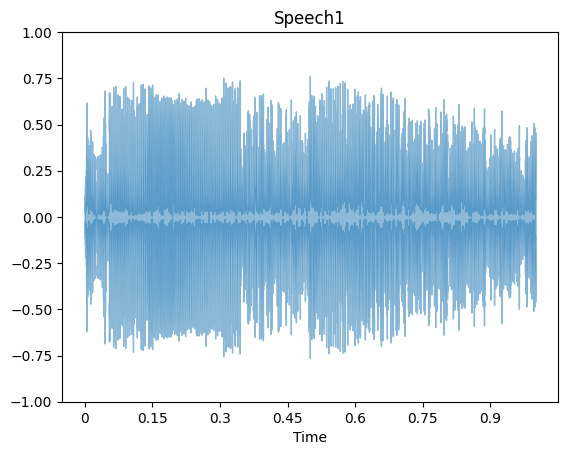

In [ ]:
plt.figure()
librosa.display.waveshow(speech,alpha=0.5)
plt.title("Speech1")
plt.ylim((-1,1))
plt.show()

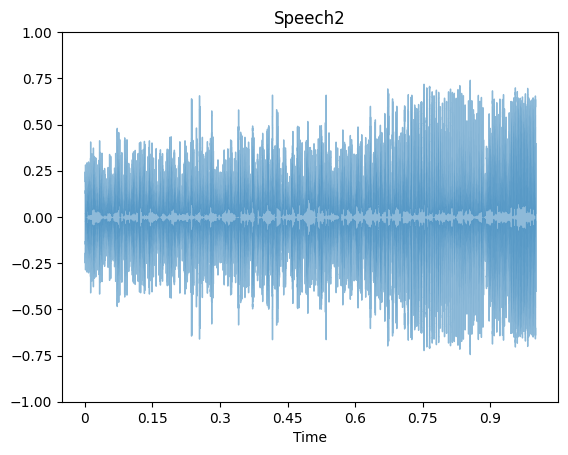

In [ ]:
plt.figure()
librosa.display.waveshow(speech2,alpha=0.5)
plt.title("Speech2")
plt.ylim((-1,1))
plt.show()

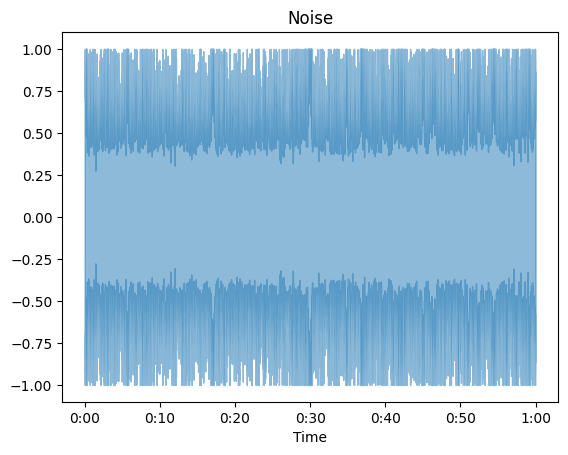

In [ ]:
plt.figure()
librosa.display.waveshow(noise,alpha=0.5)
plt.title("Noise")
#plt.ylim((-1,1))
plt.show()

## De-noising methods

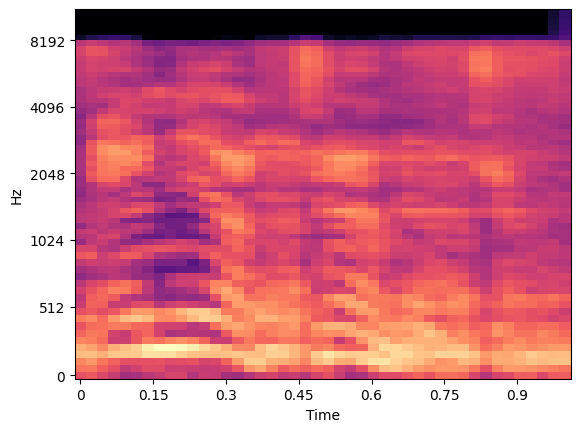

In [ ]:
S1 = librosa.feature.melspectrogram(y=speech,sr=sr,n_mels=64)
D1 = librosa.power_to_db(S1,ref=np.max)
librosa.display.specshow(D1,x_axis='time',y_axis='mel')

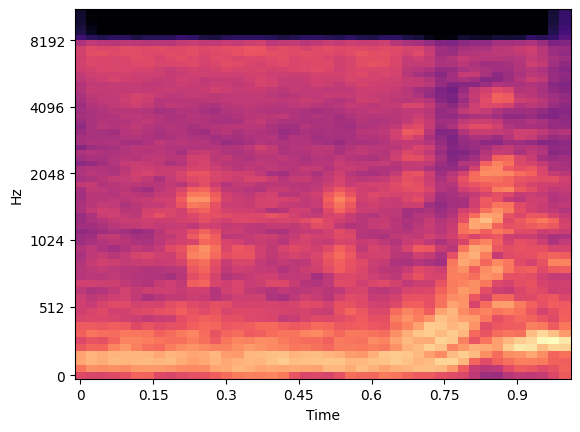

In [ ]:
S2 = librosa.feature.melspectrogram(y=speech2,sr=sr,n_mels=64)
D2 = librosa.power_to_db(S2,ref=np.max)
librosa.display.specshow(D2,x_axis='time',y_axis='mel')

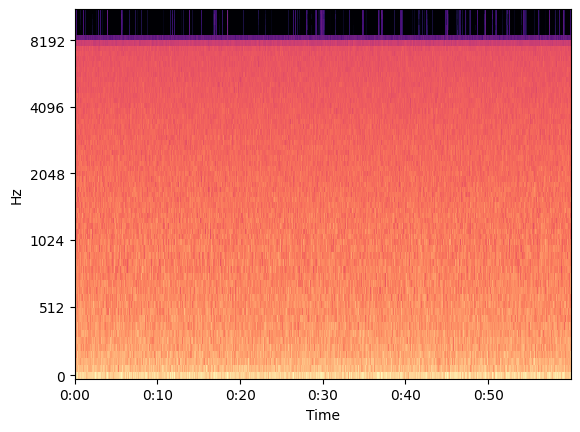

In [ ]:
S3 = librosa.feature.melspectrogram(y=noise,sr=sr,n_mels=64)
D3 = librosa.power_to_db(S3,ref=np.max)
librosa.display.specshow(D3,x_axis='time',y_axis='mel')

# HighPass filter. *Not good results*

In [ ]:
from scipy import signal
import random

def f_high(y,sr):
  b,a = signal.butter(10,1024/(sr/2),btype='highpass')
  yf = signal.lfilter(b,a,y)
  return yf

In [ ]:
yf1 = f_high(speech,sr)
yf2 = f_high(speech2,sr)

<ipython-input-127-02d271cd14e9>:1: FutureWarning: waveshow() keyword argument 'x_axis' has been renamed to 'axis' in version 0.10.0.
	This alias will be removed in version 1.0.
  librosa.display.waveshow(speech,sr=sr,x_axis='time')
<ipython-input-127-02d271cd14e9>:2: FutureWarning: waveshow() keyword argument 'x_axis' has been renamed to 'axis' in version 0.10.0.
	This alias will be removed in version 1.0.
  librosa.display.waveshow(yf1,sr=sr,x_axis='time')


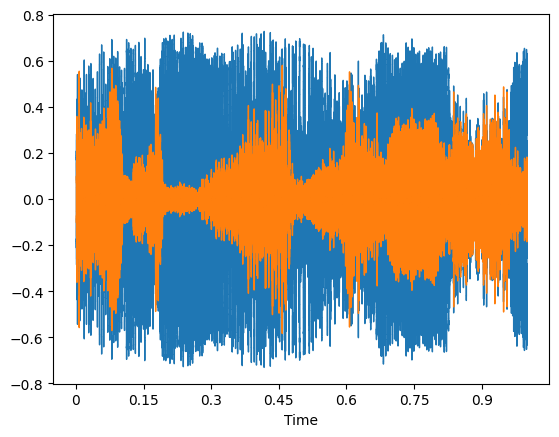

In [ ]:
librosa.display.waveshow(speech,sr=sr,x_axis='time')
librosa.display.waveshow(yf1,sr=sr,x_axis='time')

<ipython-input-128-3e4ed689fa2d>:1: FutureWarning: waveshow() keyword argument 'x_axis' has been renamed to 'axis' in version 0.10.0.
	This alias will be removed in version 1.0.
  librosa.display.waveshow(speech2,sr=sr,x_axis='time')
<ipython-input-128-3e4ed689fa2d>:2: FutureWarning: waveshow() keyword argument 'x_axis' has been renamed to 'axis' in version 0.10.0.
	This alias will be removed in version 1.0.
  librosa.display.waveshow(yf2,sr=sr,x_axis='time')


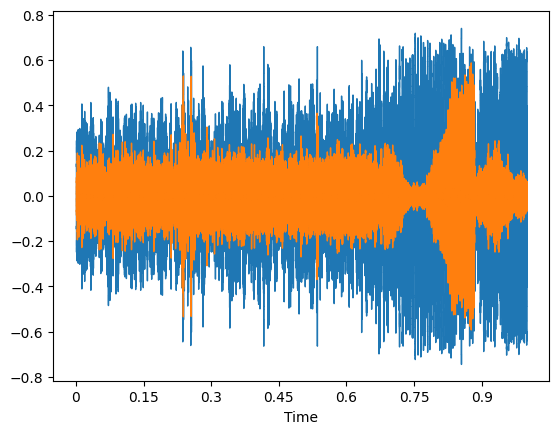

In [ ]:
librosa.display.waveshow(speech2,sr=sr,x_axis='time')
librosa.display.waveshow(yf2,sr=sr,x_axis='time')

In [ ]:
Audio(data=yf1,rate=sr)

# PCEN *Not good results*

In [ ]:
Dp1 = librosa.pcen(S1*(2**31),sr=sr,gain=1.1,hop_length=512,bias=2,power=0.5,time_constant=0.8,eps=1e-06,max_size=2)
Dp2 = librosa.pcen(S2*(2**31),sr=sr,gain=1.1,hop_length=512,bias=2,power=0.5,time_constant=0.8,eps=1e-06,max_size=2)

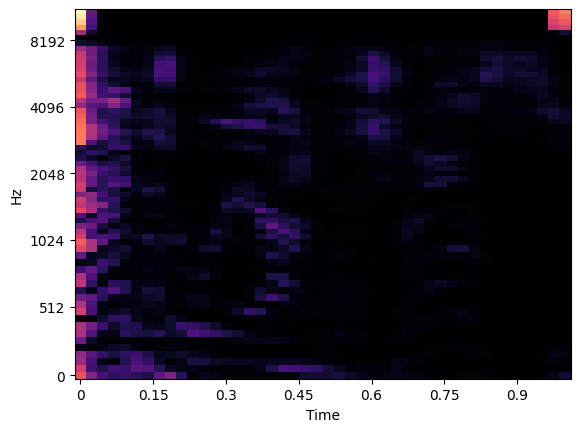

In [ ]:
librosa.display.specshow(Dp1,x_axis='time',y_axis='mel')

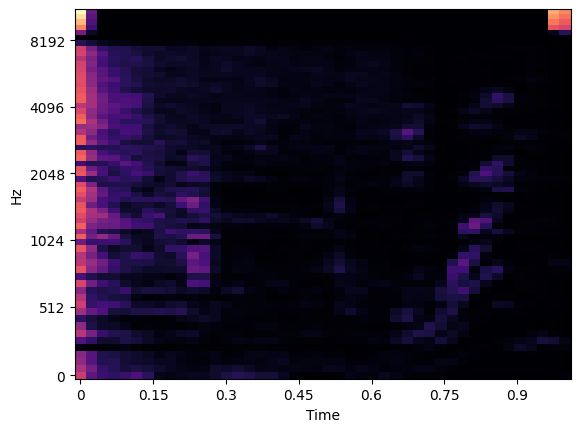

In [ ]:
librosa.display.specshow(Dp2,x_axis='time',y_axis='mel')

In [ ]:
yp1 = librosa.feature.inverse.mel_to_audio(Dp1)
yp2 = librosa.feature.inverse.mel_to_audio(Dp2)

<ipython-input-148-391cad294892>:1: FutureWarning: waveshow() keyword argument 'x_axis' has been renamed to 'axis' in version 0.10.0.
	This alias will be removed in version 1.0.
  librosa.display.waveshow(yp1,sr=sr,x_axis='time')
<ipython-input-148-391cad294892>:2: FutureWarning: waveshow() keyword argument 'x_axis' has been renamed to 'axis' in version 0.10.0.
	This alias will be removed in version 1.0.
  librosa.display.waveshow(speech,sr=sr,x_axis='time')


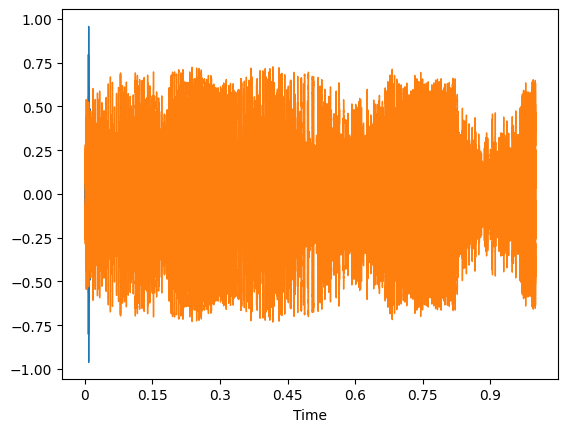

In [ ]:
librosa.display.waveshow(yp1,sr=sr,x_axis='time')
librosa.display.waveshow(speech,sr=sr,x_axis='time')

<ipython-input-152-d884cea75170>:1: FutureWarning: waveshow() keyword argument 'x_axis' has been renamed to 'axis' in version 0.10.0.
	This alias will be removed in version 1.0.
  librosa.display.waveshow(speech2,sr=sr,x_axis='time')
<ipython-input-152-d884cea75170>:2: FutureWarning: waveshow() keyword argument 'x_axis' has been renamed to 'axis' in version 0.10.0.
	This alias will be removed in version 1.0.
  librosa.display.waveshow(yp2,sr=sr,x_axis='time')


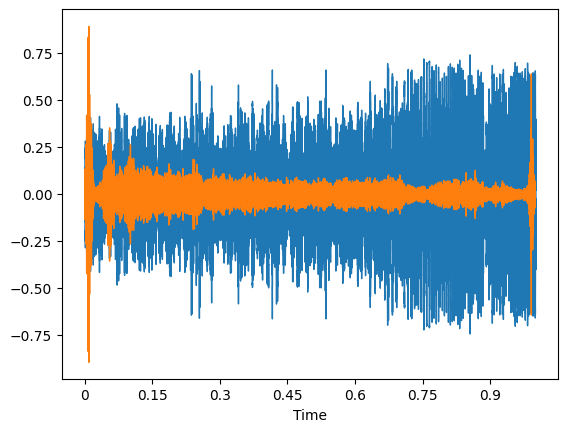

In [ ]:
librosa.display.waveshow(speech2,sr=sr,x_axis='time')
librosa.display.waveshow(yp2,sr=sr,x_axis='time')

In [ ]:
Audio(yp2,rate=sr)

# Spectral Gating

In [ ]:
import time
from datetime import timedelta as td


def _stft(y, n_fft, hop_length, win_length):
    return librosa.stft(y=y, n_fft=n_fft, hop_length=hop_length, win_length=win_length)


def _istft(y, hop_length, win_length):
    return librosa.istft(y, hop_length=hop_length, win_length=win_length)


def _amp_to_db(x):
    return librosa.core.amplitude_to_db(x, ref=1.0, amin=1e-20, top_db=80.0)


def _db_to_amp(x,):
    return librosa.core.db_to_amplitude(x, ref=1.0)


def plot_spectrogram(signal, title):
    fig, ax = plt.subplots(figsize=(20, 4))
    cax = ax.matshow(
        signal,
        origin="lower",
        aspect="auto",
        cmap=plt.cm.seismic,
        vmin=-1 * np.max(np.abs(signal)),
        vmax=np.max(np.abs(signal)),
    )
    fig.colorbar(cax)
    ax.set_title(title)
    plt.tight_layout()
    plt.show()


def plot_statistics_and_filter(
    mean_freq_noise, std_freq_noise, noise_thresh, smoothing_filter
):
    fig, ax = plt.subplots(ncols=2, figsize=(20, 4))
    plt_mean, = ax[0].plot(mean_freq_noise, label="Mean power of noise")
    plt_std, = ax[0].plot(std_freq_noise, label="Std. power of noise")
    plt_std, = ax[0].plot(noise_thresh, label="Noise threshold (by frequency)")
    ax[0].set_title("Threshold for mask")
    ax[0].legend()
    cax = ax[1].matshow(smoothing_filter, origin="lower")
    fig.colorbar(cax)
    ax[1].set_title("Filter for smoothing Mask")
    plt.show()

def removeNoise(
    audio_clip,
    noise_clip,
    n_grad_freq=2,
    n_grad_time=4,
    n_fft=2048,
    win_length=2048,
    hop_length=512,
    n_std_thresh=1.5,
    prop_decrease=1.0,
    verbose=False,
    visual=False,
):
    """Remove noise from audio based upon a clip containing only noise

    Args:
        audio_clip (array): The first parameter.
        noise_clip (array): The second parameter.
        n_grad_freq (int): how many frequency channels to smooth over with the mask.
        n_grad_time (int): how many time channels to smooth over with the mask.
        n_fft (int): number audio of frames between STFT columns.
        win_length (int): Each frame of audio is windowed by `window()`. The window will be of length `win_length` and then padded with zeros to match `n_fft`..
        hop_length (int):number audio of frames between STFT columns.
        n_std_thresh (int): how many standard deviations louder than the mean dB of the noise (at each frequency level) to be considered signal
        prop_decrease (float): To what extent should you decrease noise (1 = all, 0 = none)
        visual (bool): Whether to plot the steps of the algorithm

    Returns:
        array: The recovered signal with noise subtracted

    """
    if verbose:
        start = time.time()
    # STFT over noise
    noise_stft = _stft(noise_clip, n_fft, hop_length, win_length)
    noise_stft_db = _amp_to_db(np.abs(noise_stft))  # convert to dB
    # Calculate statistics over noise
    mean_freq_noise = np.mean(noise_stft_db, axis=1)
    std_freq_noise = np.std(noise_stft_db, axis=1)
    noise_thresh = mean_freq_noise + std_freq_noise * n_std_thresh
    if verbose:
        print("STFT on noise:", td(seconds=time.time() - start))
        start = time.time()
    # STFT over signal
    if verbose:
        start = time.time()
    sig_stft = _stft(audio_clip, n_fft, hop_length, win_length)
    sig_stft_db = _amp_to_db(np.abs(sig_stft))
    if verbose:
        print("STFT on signal:", td(seconds=time.time() - start))
        start = time.time()
    # Calculate value to mask dB to
    mask_gain_dB = np.min(_amp_to_db(np.abs(sig_stft)))
    #print(noise_thresh, mask_gain_dB)
    # Create a smoothing filter for the mask in time and frequency
    smoothing_filter = np.outer(
        np.concatenate(
            [
                np.linspace(0, 1, n_grad_freq + 1, endpoint=False),
                np.linspace(1, 0, n_grad_freq + 2),
            ]
        )[1:-1],
        np.concatenate(
            [
                np.linspace(0, 1, n_grad_time + 1, endpoint=False),
                np.linspace(1, 0, n_grad_time + 2),
            ]
        )[1:-1],
    )
    smoothing_filter = smoothing_filter / np.sum(smoothing_filter)
    # calculate the threshold for each frequency/time bin
    db_thresh = np.repeat(
        np.reshape(noise_thresh, [1, len(mean_freq_noise)]),
        np.shape(sig_stft_db)[1],
        axis=0,
    ).T
    # mask if the signal is above the threshold
    sig_mask = sig_stft_db < db_thresh
    if verbose:
        print("Masking:", td(seconds=time.time() - start))
        start = time.time()
    # convolve the mask with a smoothing filter
    sig_mask = scipy.signal.fftconvolve(sig_mask, smoothing_filter, mode="same")
    sig_mask = sig_mask * prop_decrease
    if verbose:
        print("Mask convolution:", td(seconds=time.time() - start))
        start = time.time()
    # mask the signal
    sig_stft_db_masked = (
        sig_stft_db * (1 - sig_mask)
        + np.ones(np.shape(mask_gain_dB)) * mask_gain_dB * sig_mask
    )  # mask real
    sig_imag_masked = np.imag(sig_stft) * (1 - sig_mask)
    sig_stft_amp = (_db_to_amp(sig_stft_db_masked) * np.sign(sig_stft)) + (
        1j * sig_imag_masked
    )
    if verbose:
        print("Mask application:", td(seconds=time.time() - start))
        start = time.time()
    # recover the signal
    recovered_signal = _istft(sig_stft_amp, hop_length, win_length)
    recovered_spec = _amp_to_db(
        np.abs(_stft(recovered_signal, n_fft, hop_length, win_length))
    )
    if verbose:
        print("Signal recovery:", td(seconds=time.time() - start))
    if visual:
        plot_spectrogram(noise_stft_db, title="Noise")
    if visual:
        plot_statistics_and_filter(
            mean_freq_noise, std_freq_noise, noise_thresh, smoothing_filter
        )
    if visual:
        plot_spectrogram(sig_stft_db, title="Signal")
    if visual:
        plot_spectrogram(sig_mask, title="Mask applied")
    if visual:
        plot_spectrogram(sig_stft_db_masked, title="Masked signal")
    if visual:
        plot_spectrogram(recovered_spec, title="Recovered spectrogram")
    return recovered_signal

In [ ]:
noise1 = noise[4*sr:5*sr]
Audio(noise1,rate=sr)

In [ ]:
yg1 = removeNoise(audio_clip=speech, noise_clip=noise,
    n_grad_freq=2,
    n_grad_time=4,
    n_fft=2048,
    win_length=2048,
    hop_length=512,
    n_std_thresh=2.0,
    prop_decrease=1.0,
    verbose=False,
    visual=False)

<ipython-input-252-22c0d823fa2e>:1: FutureWarning: waveshow() keyword argument 'x_axis' has been renamed to 'axis' in version 0.10.0.
	This alias will be removed in version 1.0.
  librosa.display.waveshow(speech,sr=sr,x_axis='time')
<ipython-input-252-22c0d823fa2e>:2: FutureWarning: waveshow() keyword argument 'x_axis' has been renamed to 'axis' in version 0.10.0.
	This alias will be removed in version 1.0.
  librosa.display.waveshow(yg1,sr=sr,x_axis='time')


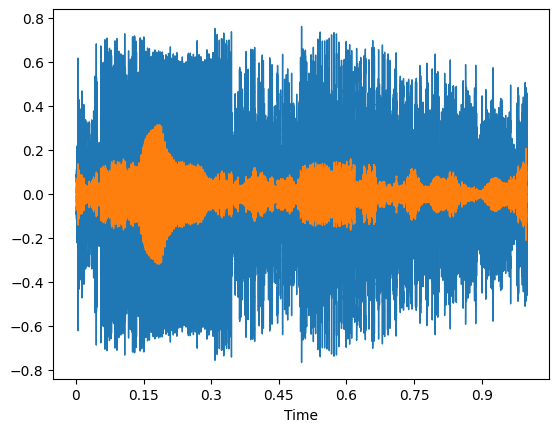

In [ ]:
librosa.display.waveshow(speech,sr=sr,x_axis='time')
librosa.display.waveshow(yg1,sr=sr,x_axis='time')

In [ ]:
yg2 = removeNoise(audio_clip=speech2, noise_clip=noise,
    n_grad_freq=2,
    n_grad_time=4,
    n_fft=2048,
    win_length=2048,
    hop_length=512,
    n_std_thresh=2.0,
    prop_decrease=1.0,
    verbose=False,
    visual=False)

<ipython-input-251-62aab5f725e2>:1: FutureWarning: waveshow() keyword argument 'x_axis' has been renamed to 'axis' in version 0.10.0.
	This alias will be removed in version 1.0.
  librosa.display.waveshow(speech2,sr=sr,x_axis='time')
<ipython-input-251-62aab5f725e2>:2: FutureWarning: waveshow() keyword argument 'x_axis' has been renamed to 'axis' in version 0.10.0.
	This alias will be removed in version 1.0.
  librosa.display.waveshow(yg2,sr=sr,x_axis='time')


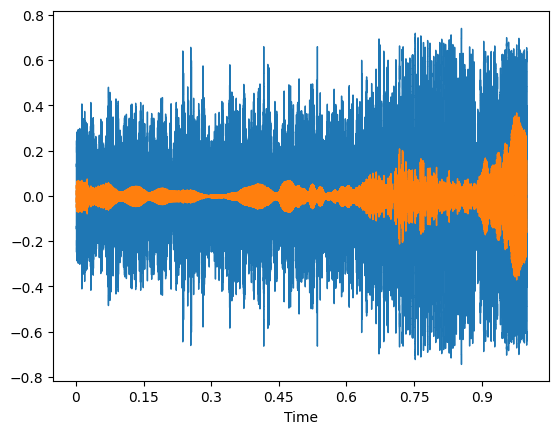

In [ ]:
librosa.display.waveshow(speech2,sr=sr,x_axis='time')
librosa.display.waveshow(yg2,sr=sr,x_axis='time')

In [ ]:
Audio(yg2,rate=sr)

# MFCC

In [ ]:
n_fft = 512
win_length = 441
hop_length = 220

In [ ]:
mfccs = librosa.feature.mfcc(y=speech2,win_length=win_length,n_fft=n_fft,hop_length=hop_length,sr=sr,n_mfcc=20)

In [ ]:
mfccs.shape

(20, 101)

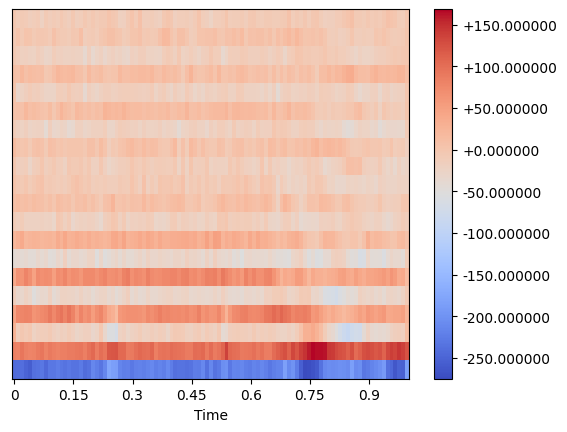

In [ ]:
plt.figure()
librosa.display.specshow(mfccs,x_axis='time', sr=sr, hop_length=hop_length)
plt.colorbar(format="%+2f")
plt.show()

In [ ]:
#delta mfccs
delta_mfccs = librosa.feature.delta(mfccs)
delta2_mfccs = librosa.feature.delta(mfccs,order=2)

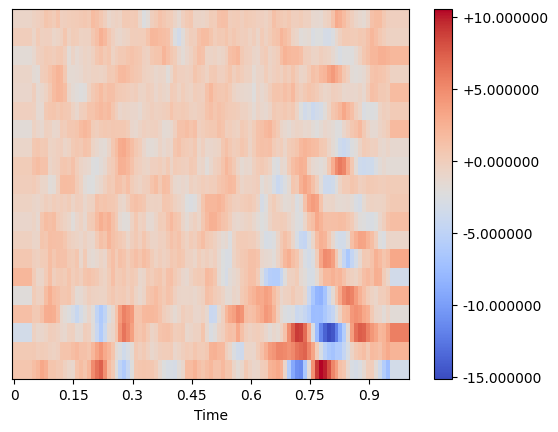

In [ ]:
plt.figure()
librosa.display.specshow(delta_mfccs,x_axis='time',sr=sr,hop_length=hop_length)
plt.colorbar(format="%+2f")
plt.show()

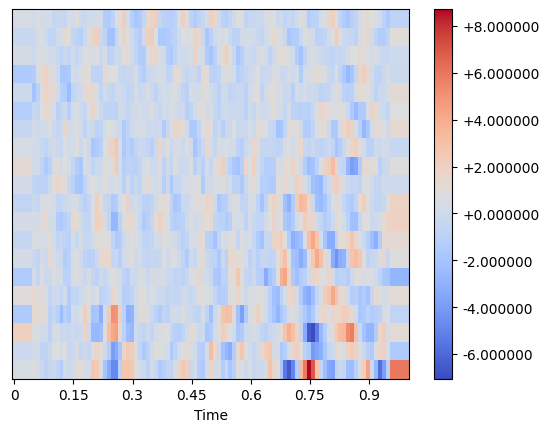

In [ ]:
plt.figure()
librosa.display.specshow(delta2_mfccs,x_axis='time',sr=sr,hop_length=hop_length)
plt.colorbar(format="%+2f")
plt.show()

In [ ]:
comprehensive_mfccs = np.concatenate((mfccs,delta_mfccs,delta2_mfccs))
print(comprehensive_mfccs.shape)

(39, 44)


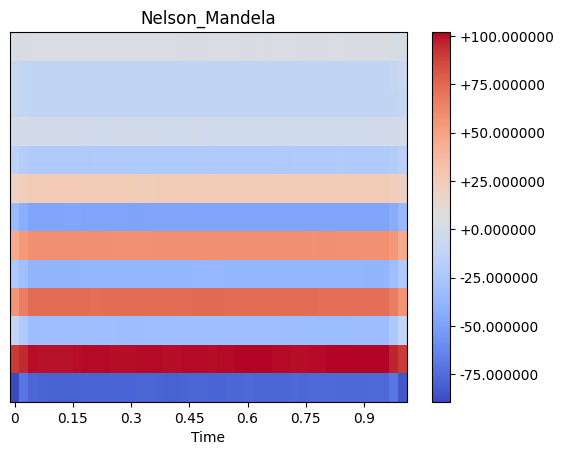

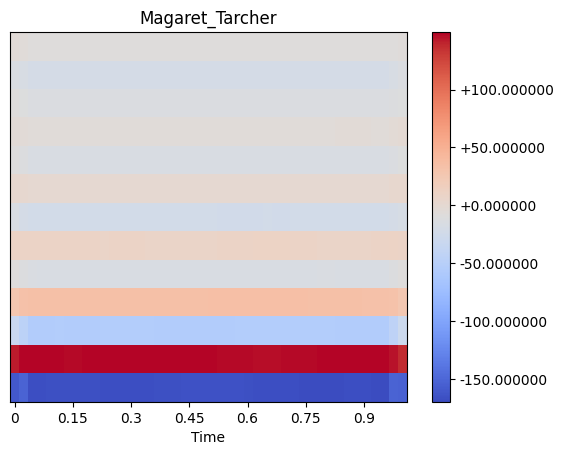

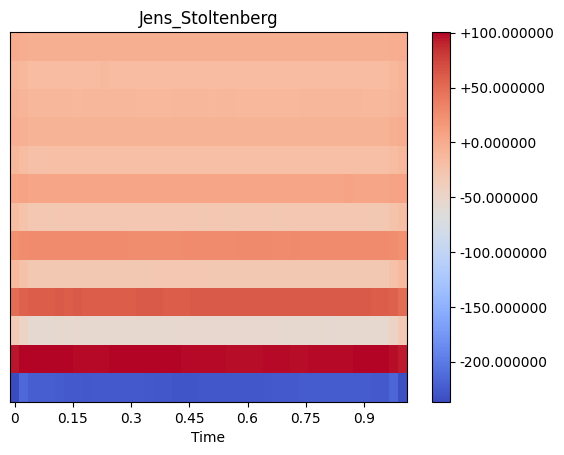

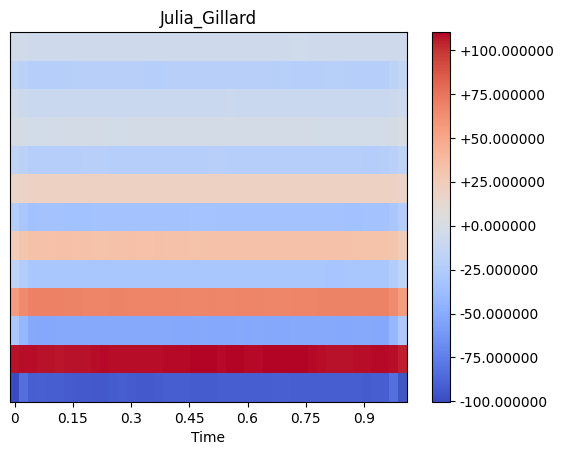

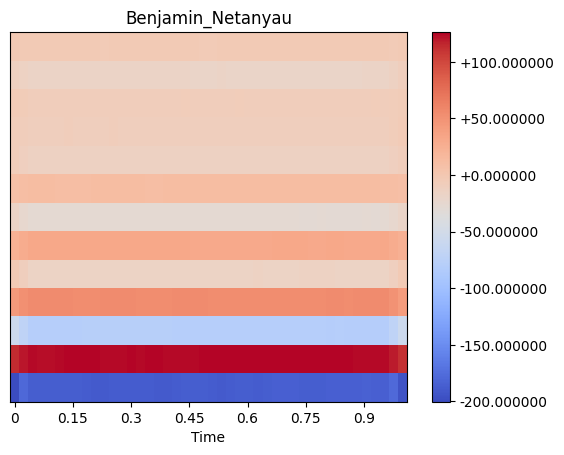

{0: 'Nelson_Mandela', 1: 'Magaret_Tarcher', 2: 'Jens_Stoltenberg', 3: 'Julia_Gillard', 4: 'Benjamin_Netanyau'}


In [ ]:
dir_path = r'/content/speaker-recognition-dataset/16000_pcm_speeches'
label = {}
label_count = 0
for x in os.listdir(dir_path):
  if x in ['other','_background_noise_','tf_Wav_reader.py']:
    continue
  label[label_count] = x
  sub_dir_path = os.path.join(dir_path,x)
  if os.path.isdir(sub_dir_path):
    count = 0
    speaker_data = np.zeros((13,44))
    for y in os.listdir(sub_dir_path):
      file_path = os.path.join(sub_dir_path,y)
      if os.path.isfile(file_path):
        audio_data, sample_rate = librosa.load(file_path)
        mfccs = librosa.feature.mfcc(y=audio_data,n_mfcc=13,sr=sr)
        speaker_data = speaker_data + mfccs
        #delta_mfccs = librosa.feature.delta(mfccs)
        #delta2_mfccs = librosa.feature.delta(mfccs,order=2)
        count += 1
    label_count += 1
    speaker_data = speaker_data/1500
    plt.figure()
    librosa.display.specshow(speaker_data,x_axis='time',sr=sr)
    plt.colorbar(format="%+2f")
    plt.title(x)
    plt.show()
print(label)

## **Amplitude Envelope**

In [ ]:
def amplitude_envelope(signal,frame_size,hop_length):
  amplitude_envelope = []

  for i in range(0,len(signal),hop_length):
    current_frame_amplitude_envelope = max(signal[i:i+frame_size])
    amplitude_envelope.append(current_frame_amplitude_envelope)

  return np.array(amplitude_envelope)

def fancy_amplitude_envelope(signal,frame_size,hop_length):
  return np.array([max(signal[i:i+frame_size]) for i in range(0,signal.size,hop_length)])

In [ ]:

#ac_speech = amplitude_envelope(speech,FRAME_SIZE,HOP_LENGTH)
ac_speech = fancy_amplitude_envelope(speech,FRAME_SIZE,HOP_LENGTH)

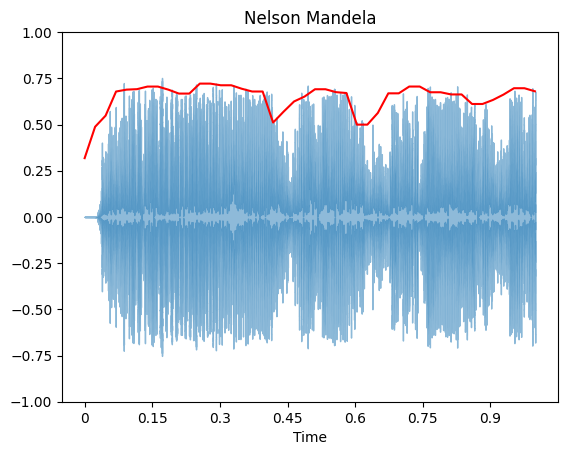

In [ ]:
frames = range(0,ac_speech.size)
t = librosa.frames_to_time(frames,hop_length=HOP_LENGTH)

plt.figure()
librosa.display.waveshow(speech,alpha=0.5)
plt.plot(t,ac_speech,color='r')
plt.title("Nelson Mandela")
plt.ylim((-1,1))
plt.show()

In [ ]:
dir_path = r'/content/speaker-recognition-dataset/16000_pcm_speeches'
amplitude_envelope_data = pd.DataFrame(columns=np.arange(44))
label = {}
label_count = 0
for x in os.listdir(dir_path):
  if x in ['other','_background_noise_','tf_Wav_reader.py']:
    continue
  label[label_count] = x
  sub_dir_path = os.path.join(dir_path,x)
  if os.path.isdir(sub_dir_path):
    count = 0
    speaker_data = pd.DataFrame(columns=np.arange(44))
    for y in os.listdir(sub_dir_path):
      file_path = os.path.join(sub_dir_path,y)
      if os.path.isfile(file_path):
        audio_data, sample_rate = librosa.load(file_path)
        ac_speech = fancy_amplitude_envelope(audio_data,FRAME_SIZE,HOP_LENGTH)
        speaker_data.loc[count] = ac_speech
        count += 1
    amplitude_envelope_data.loc[label_count] = speaker_data.mean(axis=0)
    label_count += 1
print(label)

(1, 44)
(2, 44)
(3, 44)
(4, 44)
(5, 44)
{0: 'Jens_Stoltenberg', 1: 'Nelson_Mandela', 2: 'Benjamin_Netanyau', 3: 'Magaret_Tarcher', 4: 'Julia_Gillard'}


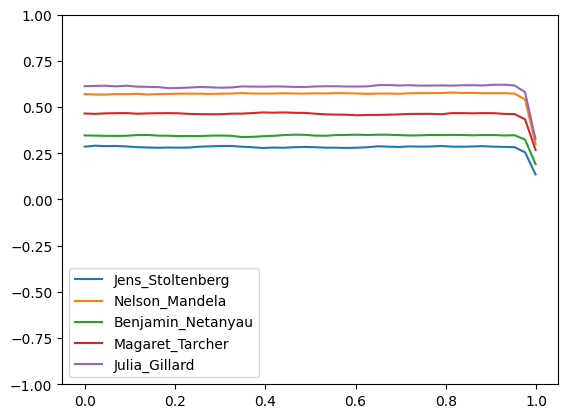

In [ ]:
frames = range(0,amplitude_envelope_data.loc[0].size)
t = librosa.frames_to_time(frames,hop_length=HOP_LENGTH)
plt.figure()
for x in label.keys():
  plt.plot(t,amplitude_envelope_data.loc[x],label=label[x])
plt.ylim((-1,1))
plt.legend()
plt.show()

# **Root-Mean Square Energy**

In [ ]:
rms_speech = librosa.feature.rms(y=speech,frame_length=FRAME_SIZE,hop_length=HOP_LENGTH)[0]

In [ ]:
rms_speech.shape

(44,)

In [ ]:
np.mean(rms_speech)

0.2625984

In [ ]:
threshold = 0.17

In [ ]:
dir_path = r'/content/speaker-recognition-dataset/16000_pcm_speeches'
count = 0
for x in os.listdir(dir_path):
  if x != 'Nelson_Mandela':
    continue
  sub_dir_path = os.path.join(dir_path,x)
  if os.path.isdir(sub_dir_path):
    for y in os.listdir(sub_dir_path):
      file_path = os.path.join(sub_dir_path,y)
      if os.path.isfile(file_path):
        audio_data, sample_rate = librosa.load(file_path)
        rms_speech = librosa.feature.rms(y=audio_data,frame_length=FRAME_SIZE,hop_length=HOP_LENGTH)[0]
        m = np.mean(rms_speech)
        if m <= threshold:
          print(file_path)
          count += 1
print(count)

/content/speaker-recognition-dataset/16000_pcm_speeches/Nelson_Mandela/1161.wav
/content/speaker-recognition-dataset/16000_pcm_speeches/Nelson_Mandela/1318.wav
/content/speaker-recognition-dataset/16000_pcm_speeches/Nelson_Mandela/531.wav
/content/speaker-recognition-dataset/16000_pcm_speeches/Nelson_Mandela/219.wav
/content/speaker-recognition-dataset/16000_pcm_speeches/Nelson_Mandela/1059.wav
/content/speaker-recognition-dataset/16000_pcm_speeches/Nelson_Mandela/1002.wav
/content/speaker-recognition-dataset/16000_pcm_speeches/Nelson_Mandela/54.wav
/content/speaker-recognition-dataset/16000_pcm_speeches/Nelson_Mandela/808.wav
/content/speaker-recognition-dataset/16000_pcm_speeches/Nelson_Mandela/346.wav
/content/speaker-recognition-dataset/16000_pcm_speeches/Nelson_Mandela/975.wav
/content/speaker-recognition-dataset/16000_pcm_speeches/Nelson_Mandela/88.wav
/content/speaker-recognition-dataset/16000_pcm_speeches/Nelson_Mandela/751.wav
/content/speaker-recognition-dataset/16000_pcm_spe

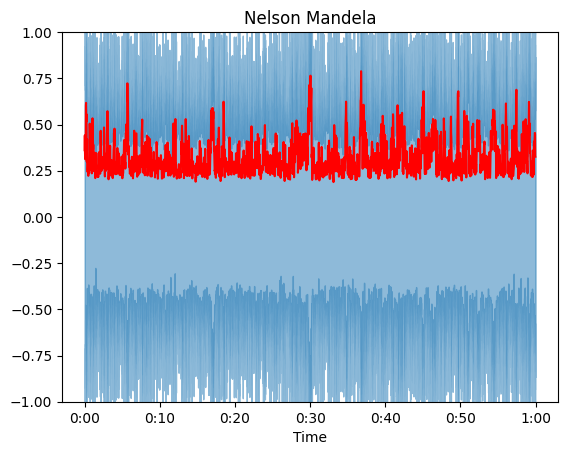

In [ ]:
frames = range(0,rms_speech.size)
t = librosa.frames_to_time(frames,hop_length=HOP_LENGTH)

plt.figure()
librosa.display.waveshow(speech,alpha=0.5)
plt.plot(t,rms_speech,color='r')
plt.title("Nelson Mandela")
plt.ylim((-1,1))
plt.show()

In [ ]:
dir_path = r'/content/speaker-recognition-dataset/16000_pcm_speeches'
rms_data = pd.DataFrame(columns=np.arange(44))
label = {}
label_count = 0
for x in os.listdir(dir_path):
  if x in ['other','_background_noise_','tf_Wav_reader.py']:
    continue
  label[label_count] = x
  sub_dir_path = os.path.join(dir_path,x)
  if os.path.isdir(sub_dir_path):
    count = 0
    speaker_data = pd.DataFrame(columns=np.arange(44))
    for y in os.listdir(sub_dir_path):
      file_path = os.path.join(sub_dir_path,y)
      if os.path.isfile(file_path):
        audio_data, sample_rate = librosa.load(file_path)
        rms_speech = librosa.feature.rms(y=audio_data,frame_length=FRAME_SIZE,hop_length=HOP_LENGTH)[0]
        speaker_data.loc[count] = rms_speech
        count += 1
    rms_data.loc[label_count] = speaker_data.mean(axis=0)
    label_count += 1
print(rms_data.shape)
print(label)

(5, 44)
{0: 'Jens_Stoltenberg', 1: 'Nelson_Mandela', 2: 'Benjamin_Netanyau', 3: 'Magaret_Tarcher', 4: 'Julia_Gillard'}


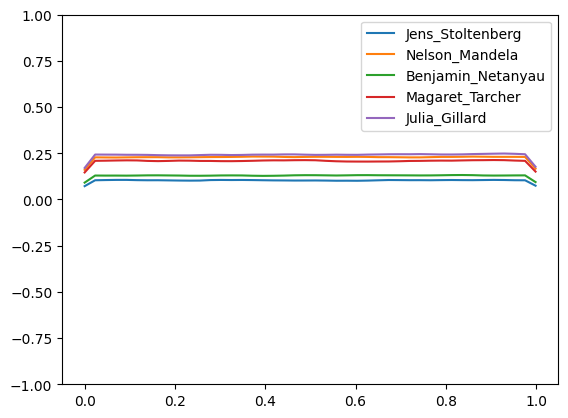

In [ ]:
frames = range(0,rms_data.loc[0].size)
t = librosa.frames_to_time(frames,hop_length=HOP_LENGTH)
plt.figure()
for x in label.keys():
  plt.plot(t,rms_data.loc[x],label=label[x])
plt.ylim((-1,1))
plt.legend()
plt.show()

# **Zero Crossing rate**

In [ ]:
zcr_speech = librosa.feature.zero_crossing_rate(noise,frame_length=FRAME_SIZE,hop_length=HOP_LENGTH)[0]

In [ ]:
np.max(zcr_speech)*FRAME_SIZE

237.0

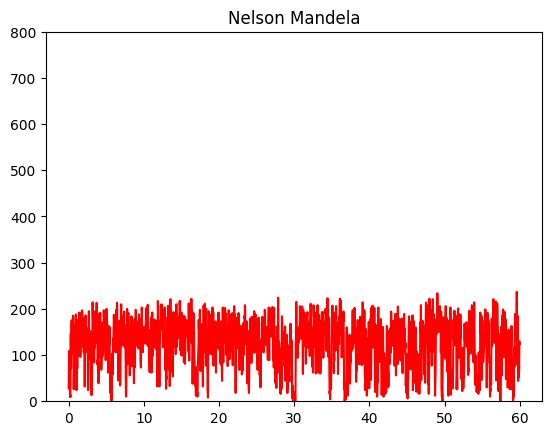

In [ ]:
frames = range(0,zcr_speech.size)
t = librosa.frames_to_time(frames,hop_length=HOP_LENGTH)

plt.figure()
#librosa.display.waveshow(speech,alpha=0.5)
plt.plot(t,zcr_speech*FRAME_SIZE,color='r')
plt.title("Nelson Mandela")
plt.ylim((0,800))
plt.show()

In [ ]:
dir_path = r'/content/speaker-recognition-dataset/16000_pcm_speeches'
zcr_data = pd.DataFrame(columns=np.arange(44))
label = {}
label_count = 0
for x in os.listdir(dir_path):
  if x in ['other','_background_noise_','tf_Wav_reader.py']:
    continue
  label[label_count] = x
  sub_dir_path = os.path.join(dir_path,x)
  if os.path.isdir(sub_dir_path):
    count = 0
    speaker_data = pd.DataFrame(columns=np.arange(44))
    for y in os.listdir(sub_dir_path):
      file_path = os.path.join(sub_dir_path,y)
      if os.path.isfile(file_path):
        audio_data, sample_rate = librosa.load(file_path)
        zcr_speech = librosa.feature.zero_crossing_rate(speech,frame_length=FRAME_SIZE,hop_length=HOP_LENGTH)[0]
        speaker_data.loc[count] = zcr_speech
        count += 1
    zcr_data.loc[label_count] = speaker_data.mean(axis=0)
    label_count += 1
print(zcr_data.shape)
print(label)

(5, 44)
{0: 'Jens_Stoltenberg', 1: 'Nelson_Mandela', 2: 'Benjamin_Netanyau', 3: 'Magaret_Tarcher', 4: 'Julia_Gillard'}


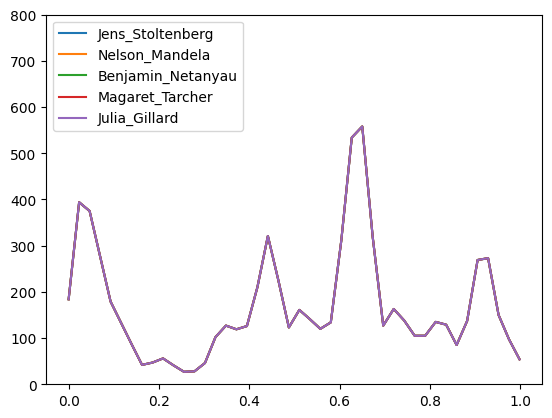

In [ ]:
frames = range(0,zcr_data.loc[0].size)
t = librosa.frames_to_time(frames,hop_length=HOP_LENGTH)
plt.figure()
for x in label.keys():
  plt.plot(t,zcr_data.loc[x]*FRAME_SIZE,label=label[x])
plt.ylim((0,800))
plt.legend()
plt.show()

# ZCR Experimental

In [ ]:
dir_path = r'/content/speaker-recognition-dataset/16000_pcm_speeches'
minute_speech = []
for x in os.listdir(dir_path):
  x = 'Nelson_Mandela'
  sub_dir_path = os.path.join(dir_path,x)
  if os.path.isdir(sub_dir_path):
    count = 0
    for y in os.listdir(sub_dir_path):
      if count >= 60:
        break
      file_path = os.path.join(sub_dir_path,y)
      if os.path.isfile(file_path):
        count += 1
        audio_data, sr = librosa.load(file_path)
        minute_speech.extend(audio_data)
  break
test_speech = np.array(minute_speech)

In [ ]:
Audio(test_speech,rate=sr)

In [ ]:
zcr_speech = librosa.feature.zero_crossing_rate(test_speech,frame_length=FRAME_SIZE,hop_length=HOP_LENGTH)[0]

In [ ]:
np.mean(zcr_speech)*FRAME_SIZE

178.39899380804954

In [ ]:
np.var(zcr_speech)*(FRAME_SIZE**2)

13009.040107346711

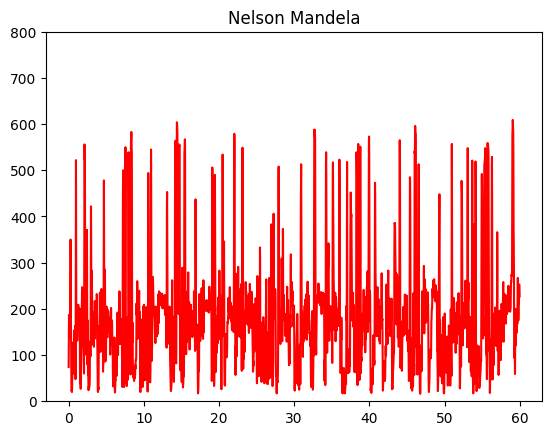

In [ ]:
frames = range(0,zcr_speech.size)
t = librosa.frames_to_time(frames,hop_length=HOP_LENGTH)

plt.figure()
#librosa.display.waveshow(speech,alpha=0.5)
plt.plot(t,zcr_speech*FRAME_SIZE,color='r')
plt.title("Nelson Mandela")
plt.ylim((0,800))
plt.show()

In [ ]:
test_speech.size/sr

60.0

In [ ]:
mean = []
var = []
for x in range(0,int(test_speech.size/sr)):
  zcr_speech = librosa.feature.zero_crossing_rate(test_speech[x*sr:(x+1)*sr],frame_length=FRAME_SIZE,hop_length=HOP_LENGTH)[0]
  mean.append(np.mean(zcr_speech)*FRAME_SIZE)
  var.append(np.var(zcr_speech)*(FRAME_SIZE**2))
print(len(mean),len(var))

60 60


In [ ]:
test_speech_2 = test_speech
for x in range(0,int(test_speech.size/sr)):
  if var[x] <= 2500:
    test_speech_2[x*sr:(x+1)*sr-1] = 0.01

In [ ]:
Audio(test_speech_2,rate=sr)

In [ ]:
print(zcr_speech.shape)
print((sr/HOP_LENGTH)*60)

(2584,)
2583.984375


In [ ]:
pr_speech = librosa.effects.preemphasis(test_speech_2,coef=0.97)

In [ ]:
denoised_speech = removeNoise(audio_clip=test_speech_2, noise_clip=noise,
    n_grad_freq=2,
    n_grad_time=4,
    n_fft=2048,
    win_length=2048,
    hop_length=512,
    n_std_thresh=1.5,
    prop_decrease=0.7,
    verbose=False,
    visual=False)

In [ ]:
Audio(denoised_speech,rate=sr)

In [ ]:
zcr_speech = librosa.feature.zero_crossing_rate(test_speech_2,frame_length=FRAME_SIZE,hop_length=HOP_LENGTH)[0]

In [ ]:
np.mean(zcr_speech)*FRAME_SIZE

131.8235294117647

In [ ]:
np.var(zcr_speech)*(FRAME_SIZE**2)

16485.411582589695

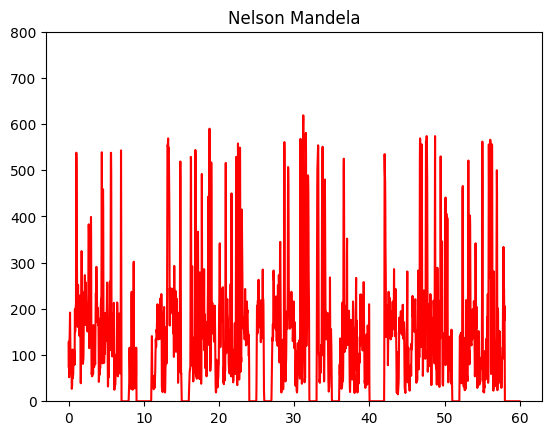

In [ ]:
frames = range(0,zcr_speech.size)
t = librosa.frames_to_time(frames,hop_length=HOP_LENGTH)

plt.figure()
#librosa.display.waveshow(speech,alpha=0.5)
plt.plot(t,zcr_speech*FRAME_SIZE,color='r')
plt.title("Nelson Mandela")
plt.ylim((0,800))
plt.show()

<ipython-input-135-c5e9ce0ccf04>:1: FutureWarning: waveshow() keyword argument 'x_axis' has been renamed to 'axis' in version 0.10.0.
	This alias will be removed in version 1.0.
  librosa.display.waveshow(test_speech,sr=sr,x_axis='time')
<ipython-input-135-c5e9ce0ccf04>:2: FutureWarning: waveshow() keyword argument 'x_axis' has been renamed to 'axis' in version 0.10.0.
	This alias will be removed in version 1.0.
  librosa.display.waveshow(denoised_speech,sr=sr,x_axis='time')


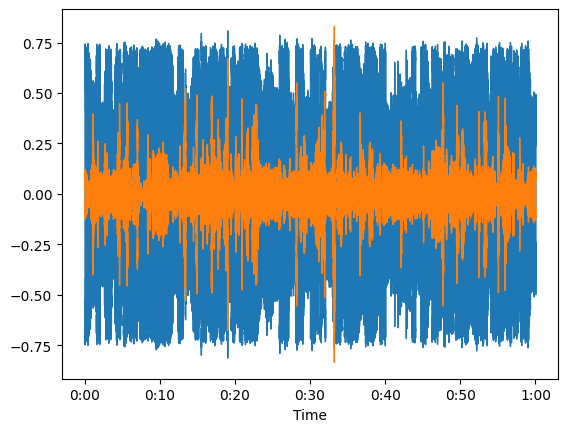

In [ ]:
librosa.display.waveshow(test_speech,sr=sr,x_axis='time')
librosa.display.waveshow(denoised_speech,sr=sr,x_axis='time')

# Fourier Transform

In [ ]:
ft = sp.fft.fft(speech[:441],n=512)
magnitude = np.absolute(ft)
frequency = np.linspace(0,sr,len(magnitude))
len(magnitude)

512

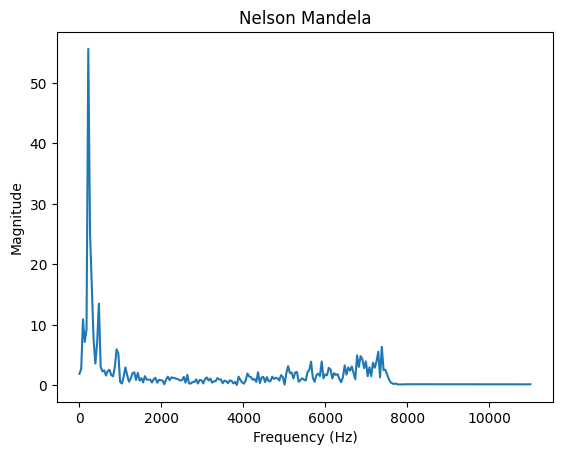

In [ ]:
plt.figure()
#librosa.display.waveshow(speech,alpha=0.5)
plt.plot(frequency[:256],magnitude[:256])
plt.title("Nelson Mandela")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Magnitude")
plt.show()

# SPEECH PARAMETERIZATION

In [ ]:
dir_path = r'/content/speaker-recognition-dataset/16000_pcm_speeches'
minute_speeches = {}
for x in os.listdir(dir_path):
  if x in ['other','_background_noise_','tf_Wav_reader.py']:
    continue
  sub_dir_path = os.path.join(dir_path,x)
  if os.path.isdir(sub_dir_path):
    minute_speech = []
    count = 0
    for y in os.listdir(sub_dir_path):
      if count >= 60:
        break
      file_path = os.path.join(sub_dir_path,y)
      if os.path.isfile(file_path):
        count += 1
        audio_data, sr = librosa.load(file_path)
        minute_speech.extend(audio_data)
    minute_speeches[x] = np.array(minute_speech)

In [ ]:
import soundfile as sf

for speaker in minute_speeches.keys():
  sf.write(f"./{speaker}.wav",minute_speeches[speaker],sr)

In [ ]:
minute_speeches.keys()

dict_keys(['Jens_Stoltenberg', 'Benjamin_Netanyau', 'Julia_Gillard', 'Nelson_Mandela', 'Magaret_Tarcher'])

In [ ]:
Audio(minute_speeches['Nelson_Mandela'],rate=sr)

In [ ]:
n_fft = 512
win_length = 441
hop_length = 220

In [ ]:
D = librosa.stft(minute_speeches['Nelson_Mandela'],n_fft=n_fft,hop_length=hop_length,win_length=win_length)

In [ ]:
D.shape

(257, 6014)

In [ ]:
mel_filterbanks = librosa.filters.mel(sr=sr,n_fft=512,n_mels=20)

In [ ]:
mel_filterbanks.shape

(20, 257)

In [ ]:
mel_spec = np.dot(mel_filterbanks,np.abs(D)**2)

In [ ]:
mel_spec.shape

(20, 6014)

In [ ]:
mel_spec_db = librosa.power_to_db(mel_spec,ref=1.0)

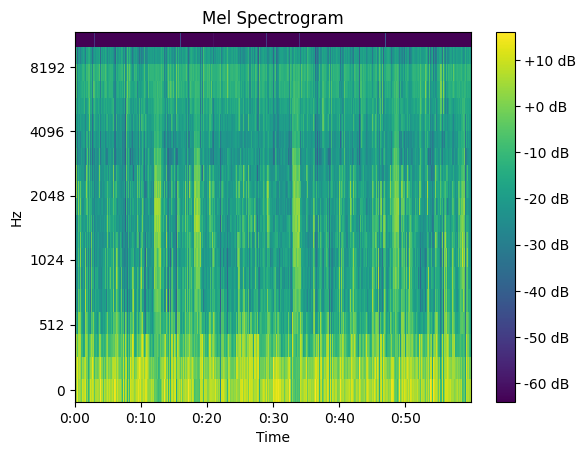

In [ ]:
librosa.display.specshow(mel_spec_db, y_axis='mel', x_axis='time', sr=sr, hop_length=220, cmap='viridis')
plt.colorbar(format='%+2.0f dB')
plt.title('Mel Spectrogram')
plt.show()

In [ ]:
from scipy.fft import dct

In [ ]:
mfccs = dct(mel_spec_db,type=2,n=20,axis=0,norm="ortho")

In [ ]:
mel_spec_db.shape[0]

20

In [ ]:
sr

22050

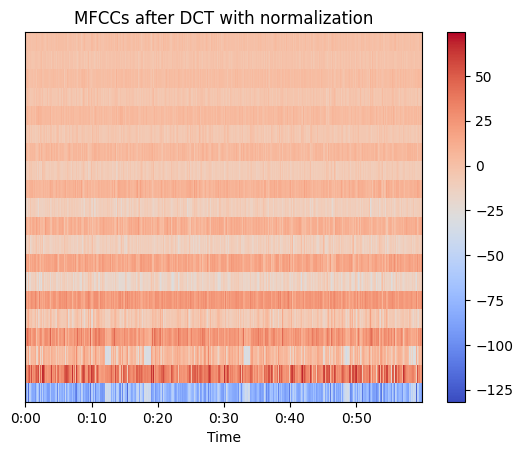

In [ ]:
librosa.display.specshow(mfccs,x_axis='time', sr=sr, hop_length=220)
plt.colorbar()
plt.title('MFCCs after DCT with normalization')
plt.show()

In [ ]:
mfccs2 = librosa.feature.mfcc(y=minute_speeches['Nelson_Mandela'],win_length=win_length,n_fft=n_fft,hop_length=hop_length,sr=sr,n_mfcc=20)

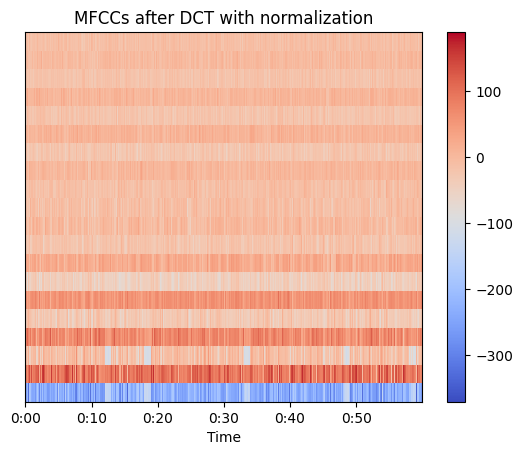

In [ ]:
librosa.display.specshow(mfccs2,x_axis='time', sr=sr, hop_length=220)
plt.colorbar()
plt.title('MFCCs after DCT with normalization')
plt.show()

# PYDUB

In [ ]:
from pydub import AudioSegment

In [ ]:
bn = AudioSegment.from_wav("/content/Benjamin_Netanyau.wav")
js = AudioSegment.from_wav("/content/Jens_Stoltenberg.wav")
jg = AudioSegment.from_wav("/content/Julia_Gillard.wav")
mt = AudioSegment.from_wav("/content/Magaret_Tarcher.wav")
nm = AudioSegment.from_wav("/content/Nelson_Mandela.wav")

In [ ]:
bn.set_frame_rate(sr)
js.set_frame_rate(sr)
jg.set_frame_rate(sr)
mt.set_frame_rate(sr)
nm.set_frame_rate(sr)

In [ ]:
nm.dBFS

-12.49052326941408

In [ ]:
bn
bn.dBFS

-15.423139036740833

In [ ]:
js
js.dBFS

-17.260203747405953

In [ ]:
jg
jg.dBFS

-11.796569603377778

In [ ]:
mt
mt.dBFS

-12.460427760289758

In [ ]:
dir_path = r'/content/speaker-recognition-dataset/16000_pcm_speeches'
dbfss = []
for x in os.listdir(dir_path):
  if x in ['other','_background_noise_','tf_Wav_reader.py']:
    continue
  sub_dir_path = os.path.join(dir_path,x)
  if os.path.isdir(sub_dir_path):
    dBFS = []
    for y in os.listdir(sub_dir_path):
      file_path = os.path.join(sub_dir_path,y)
      if os.path.isfile(file_path):
        audio = AudioSegment.from_wav(file_path)
        #audio.set_frame_rate(sr)
        dBFS.append(audio.dBFS)
    print(f"{x}: ",np.mean(dBFS))
    dbfss.append(np.mean(dBFS))
print(np.mean(dbfss))

Jens_Stoltenberg:  -19.98296723078635
Benjamin_Netanyau:  -19.37387498201216
Julia_Gillard:  -11.852052504550725
Nelson_Mandela:  -12.664541382131315
Magaret_Tarcher:  -13.493679525539585
-15.473423125004029


In [ ]:
target_dBFS = -16

In [ ]:
difference = target_dBFS - nm.dBFS
nm_adjusted = nm + difference
nm_adjusted

In [ ]:
difference = target_dBFS - bn.dBFS
bn_adjusted = bn + difference
bn_adjusted

In [ ]:
difference = target_dBFS - js.dBFS
js_adjusted = js + difference
js_adjusted

In [ ]:
difference = target_dBFS - jg.dBFS
jg_adjusted = jg + difference
jg_adjusted

In [ ]:
difference = target_dBFS - mt.dBFS
mt_adjusted = mt + difference
mt_adjusted

In [ ]:
output_path = "/content/Benjamin_Netanyau_adjusted.wav"
bn_adjusted.export(output_path,format="wav")

<_io.BufferedRandom name='/content/Benjamin_Netanyau_adjusted.wav'>

In [ ]:
output_path = "/content/Jens_Stoltenberg_adjusted.wav"
js_adjusted.export(output_path,format="wav")

<_io.BufferedRandom name='/content/Jens_Stoltenberg_adjusted.wav'>

In [ ]:
output_path = "/content/Julia_Gillard_adjusted.wav"
jg_adjusted.export(output_path,format="wav")

<_io.BufferedRandom name='/content/Julia_Gillard_adjusted.wav'>

In [ ]:
output_path = "/content/Margaret_Tarcher_adjusted.wav"
mt_adjusted.export(output_path,format="wav")

<_io.BufferedRandom name='/content/Margaret_Tarcher_adjusted.wav'>

In [ ]:
output_path = "/content/Nelson_Mandela_adjusted.wav"
nm_adjusted.export(output_path,format="wav")

<_io.BufferedRandom name='/content/Nelson_Mandela_adjusted.wav'>

# VAD

In [ ]:
bn, _ = librosa.load("/content/Benjamin_Netanyau_adjusted.wav")
js, _ = librosa.load("/content/Jens_Stoltenberg_adjusted.wav")
jg, _ = librosa.load("/content/Julia_Gillard_adjusted.wav")
mt, _ = librosa.load("/content/Margaret_Tarcher_adjusted.wav")
nm, _ = librosa.load("/content/Nelson_Mandela_adjusted.wav")

In [ ]:
Audio(bn[int(0*sr):int(59*sr)],rate=sr)

In [ ]:
Audio(bn[int(0*sr):int(1*sr)],rate=sr)

In [ ]:
Audio(js,rate=sr)

In [ ]:
Audio(jg,rate=sr)

In [ ]:
Audio(mt,rate=sr)

In [ ]:
Audio(nm,rate=sr)

In [ ]:
n_fft = 512
win_length = 441
hop_length = 220

In [ ]:
vad1 = int(sr/2)
vad2 = int(sr/4)
print(vad1,vad2)

11025 5512


In [ ]:
np.mean(var)

561.6907174556213

In [ ]:
mt_test = []
mt_c = []
for x in range(0,int(jg.size/sr)):
  zcr = librosa.feature.zero_crossing_rate(jg[int(x*sr):int((x+1)*sr)],frame_length=win_length,hop_length=hop_length)[0]
  if (np.var(zcr)*(win_length**2)) >= 380:
    mt_test = np.concatenate([mt_test,jg[int(x*sr):int((x+1)*sr)]])
  else:
    mt_c = np.concatenate([mt_c,jg[int(x*sr):int((x+1)*sr)]])

In [ ]:
mt_test = []
mt_cc = []
for x in range(0,int(mt_c.size/vad1)):
  zcr = librosa.feature.zero_crossing_rate(mt_c[int(x*vad1):int((x+1)*vad1)],frame_length=win_length,hop_length=hop_length)[0]
  if (np.var(zcr)*(win_length**2)) >= 200:
    mt_test = np.concatenate([mt_test,mt_c[int(x*vad1):int((x+1)*vad1)]])
  else:
    mt_cc = np.concatenate([mt_cc,mt_c[int(x*vad1):int((x+1)*vad1)]])

In [ ]:
mt_test = []
mt_ccc = []
for x in range(0,int(mt_cc.size/vad1)):
  zcr = librosa.feature.zero_crossing_rate(mt_cc[int(x*vad1):int((x+1)*vad1)],frame_length=win_length,hop_length=hop_length)[0]
  if not 50 <= (np.mean(zcr)*(win_length)) <= 70:
    mt_test = np.concatenate([mt_test,mt_cc[int(x*vad1):int((x+1)*vad1)]])
  else:
    mt_ccc = np.concatenate([mt_ccc,mt_cc[int(x*vad1):int((x+1)*vad1)]])

In [ ]:
Audio(mt_test,rate=sr)

In [ ]:
Audio(mt_test[3*sr:4*sr],rate=sr)

In [ ]:
Audio(mt_cc,rate=sr)

82.0163191296464
404.6905768410394


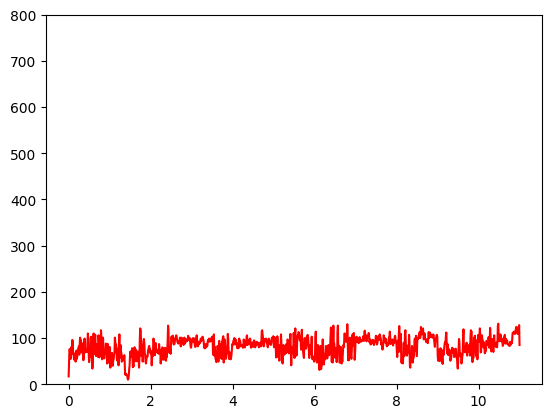

In [ ]:
zcr_speech = librosa.feature.zero_crossing_rate(mt_cc[int(0*sr):int(11*sr)],frame_length=win_length,hop_length=hop_length)[0]
print(np.mean(zcr_speech)*win_length)
print(np.var(zcr_speech)*(win_length**2))
frames = range(0,zcr_speech.size)
t = librosa.frames_to_time(frames,hop_length=hop_length)

plt.figure()
#librosa.display.waveshow(speech,alpha=0.5)
plt.plot(t,zcr_speech*win_length,color='r')
#plt.title("Nelson Mandela")
plt.ylim((0,800))
plt.show()

In [ ]:
mfccs = librosa.feature.mfcc(y=mt_cc,win_length=win_length,n_fft=n_fft,hop_length=hop_length,sr=sr,n_mfcc=20)

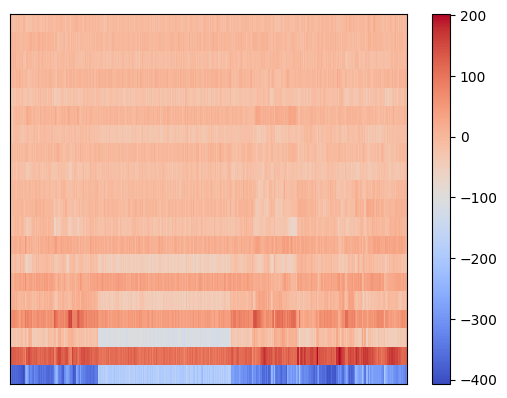

In [ ]:
librosa.display.specshow(mfccs, sr=sr, hop_length=220)
plt.colorbar()
#plt.title('MFCCs after DCT with normalization')
plt.show()

In [ ]:
for speaker in [bn,js,jg,mt,nm]:
  zcr_speech = librosa.feature.zero_crossing_rate(speaker,frame_length=win_length,hop_length=hop_length)[0]
  print(np.mean(zcr_speech)*win_length)
  print(np.var(zcr_speech)*(win_length**2))
  frames = range(0,zcr_speech.size)
  t = librosa.frames_to_time(frames,hop_length=hop_length)

  plt.figure()
  #librosa.display.waveshow(speech,alpha=0.5)
  plt.plot(t,zcr_speech*win_length,color='r')
  #plt.title("Nelson Mandela")
  plt.ylim((0,800))
  plt.show()

# TRAIN TEST SPLIT

In [ ]:
dir_path = r'/content/speaker-recognition-dataset/16000_pcm_speeches'
data = {}
for speaker in os.listdir(dir_path):
  if speaker in ['other','_background_noise_','tf_Wav_reader.py']:
    continue
  sub_dir_path = os.path.join(dir_path,speaker)
  if os.path.isdir(sub_dir_path):
    file_data = []
    speaker_data = []
    for y in os.listdir(sub_dir_path):
      file_path = os.path.join(sub_dir_path,y)
      if os.path.isfile(file_path):
        file_data.append(file_path)
        speaker_data.append(speaker)
    data[speaker] = pd.DataFrame({'Paths':file_data,'Speaker':speaker_data})
files_data = pd.DataFrame({'Paths':file_data,'Speaker':speaker_data})

In [ ]:
train_data = {}
test_data = {}
for speaker in data.keys():
  train_data[speaker],test_data[speaker] = train_test_split(data[speaker],test_size=0.2)

# FEATURES

In [ ]:
n_fft = 512
win_length = 441
hop_length = 220
sr = 22050

##MFCC

In [ ]:
from pydub import AudioSegment

In [ ]:
thresholds = {
    "Benjamin_Netanyau":{"vad1":380},
    "Jens_Stoltenberg":{"vad1":380},
    "Julia_Gillard":{"vad1":380},
    "Magaret_Tarcher":{"vad1":150},
    "Nelson_Mandela":{"vad1":1000}}

In [ ]:
!mkdir ./MFCC

## Without Normalization

In [ ]:
target_dBFS = -16
for speaker in train_data.keys():
  mfcc_data = pd.DataFrame()
  for file_path in train_data[speaker]['Paths']:
    if os.path.isfile(file_path):
      audio = AudioSegment.from_wav(file_path)
      audio.set_frame_rate(sr)
      difference = target_dBFS - audio.dBFS
      audio_adjusted = audio + difference
      output_path = "/content/adjusted.wav"
      audio_adjusted.export(output_path,format="wav")
      audio, sr = librosa.load(output_path)
      zcr = librosa.feature.zero_crossing_rate(audio,frame_length=win_length,hop_length=hop_length)[0]
      if (np.var(zcr)*(win_length**2)) >= thresholds[speaker]['vad1']:
        mfccs = librosa.feature.mfcc(y=audio,win_length=win_length,n_fft=n_fft,hop_length=hop_length,sr=sr,n_mfcc=13)
        delta_mfccs = librosa.feature.delta(mfccs)
        delta2_mfccs = librosa.feature.delta(mfccs,order=2)
        comprehensive_mfccs = np.concatenate((mfccs,delta_mfccs,delta2_mfccs))
        comprehensive_mfccs = np.transpose(comprehensive_mfccs)
        mfcc_data = pd.concat([mfcc_data,pd.DataFrame(comprehensive_mfccs)])
  mfcc_data['Speaker'] = speaker
  mfcc_data.to_csv(f'/content/MFCC/{speaker}.csv',index=False)

Load models from file or train them.

In [ ]:
speaker_models = {}
dir_path = "/content/Models"
for y in os.listdir(dir_path):
  file_path = os.path.join(dir_path,y)
  if os.path.isfile(file_path):
    if y.split(sep='.')[-1] == 'model':
      speaker = y.split(sep='.')[0]
      speaker_models[speaker] = joblib.load(file_path)

In [ ]:
speaker_models = {}
sub_dir_path = "/content/MFCC"
for y in os.listdir(sub_dir_path):
    file_path = os.path.join(sub_dir_path,y)
    if os.path.isfile(file_path):
      if y.split(sep='.')[-1] == 'csv':
        speaker = y.split(sep='.')[0]
        D = pd.read_csv(file_path)
        X = D.drop(['Speaker'],axis=1)
        speaker_models[speaker] = GaussianMixture(n_components=64,max_iter=15)
        speaker_models[speaker].fit(X)

/usr/local/lib/python3.10/dist-packages/sklearn/mixture/_base.py:274: ConvergenceWarning: Initialization 1 did not converge. Try different init parameters, or increase max_iter, tol or check for degenerate data.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/mixture/_base.py:274: ConvergenceWarning: Initialization 1 did not converge. Try different init parameters, or increase max_iter, tol or check for degenerate data.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/mixture/_base.py:274: ConvergenceWarning: Initialization 1 did not converge. Try different init parameters, or increase max_iter, tol or check for degenerate data.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/mixture/_base.py:274: ConvergenceWarning: Initialization 1 did not converge. Try different init parameters, or increase max_iter, tol or check for degenerate data.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/mixture/_base.py:274: ConvergenceWar

In [ ]:
for speaker in speaker_models.keys():
  joblib.dump(speaker_models[speaker],f"/content/Models/{speaker}_model")

In [ ]:
file_data = []
speaker_data = []
for speaker in test_data.keys():
  for file_path in test_data[speaker]['Paths']:
    if os.path.isfile(file_path):
      file_data.append(file_path)
      speaker_data.append(speaker)
files_data = pd.DataFrame({'Paths':file_data,'Speaker':speaker_data})

In [ ]:
shuffled_files = files_data.sample(frac=1)

In [ ]:
shuffled_files.shape[0]

1501

In [ ]:
random_indexes = [random.randint(0,1500) for _ in range(50)]

In [ ]:
def test(file_path):
  if os.path.isfile(file_path):
    audio = AudioSegment.from_wav(file_path)
    audio.set_frame_rate(sr)
    difference = target_dBFS - audio.dBFS
    audio_adjusted = audio + difference
    output_path = "/content/adjusted.wav"
    audio_adjusted.export(output_path,format="wav")
    audio, _ = librosa.load(output_path)
    mfccs = librosa.feature.mfcc(y=audio,win_length=win_length,n_fft=n_fft,hop_length=hop_length,sr=sr,n_mfcc=13)
    delta_mfccs = librosa.feature.delta(mfccs)
    delta2_mfccs = librosa.feature.delta(mfccs,order=2)
    comprehensive_mfccs = np.concatenate((mfccs,delta_mfccs,delta2_mfccs))
    comprehensive_mfccs = np.transpose(comprehensive_mfccs)
    mfcc_data = pd.DataFrame(comprehensive_mfccs)
  result = {}
  for speaker in speaker_models.keys():
    log_likelihoods = speaker_models[speaker].score_samples(mfcc_data)
    result[speaker] = np.exp(np.mean(log_likelihoods))
  return max(result,key=lambda k: result[k])

In [ ]:
predictions = []
for x in range(0,50):
  predictions.append(test(shuffled_files.loc[random_indexes[x]]['Paths']))

In [ ]:
correct = 0
for x in range(0,len(predictions)):
  if predictions[x] == shuffled_files.loc[random_indexes[x]]['Speaker']:
    correct += 1
  else:
    print(predictions[x],shuffled_files.loc[random_indexes[x]]['Speaker'])
print(correct)

Julia_Gillard Jens_Stoltenberg
Julia_Gillard Benjamin_Netanyau
Julia_Gillard Benjamin_Netanyau
Jens_Stoltenberg Benjamin_Netanyau
46


##With Normalization

In [ ]:
speaker_means = {}
speaker_stds = {}

In [ ]:
target_dBFS = -16
for speaker in train_data.keys():
  mfcc_data = pd.DataFrame()
  for file_path in train_data[speaker]['Paths']:
    if os.path.isfile(file_path):
      audio = AudioSegment.from_wav(file_path)
      audio.set_frame_rate(sr)
      difference = target_dBFS - audio.dBFS
      audio_adjusted = audio + difference
      output_path = "/content/adjusted.wav"
      audio_adjusted.export(output_path,format="wav")
      audio, sr = librosa.load(output_path)
      zcr = librosa.feature.zero_crossing_rate(audio,frame_length=win_length,hop_length=hop_length)[0]
      if (np.var(zcr)*(win_length**2)) >= thresholds[speaker]['vad1']:
        mfccs = librosa.feature.mfcc(y=audio,win_length=win_length,n_fft=n_fft,hop_length=hop_length,sr=sr,n_mfcc=13)
        delta_mfccs = librosa.feature.delta(mfccs)
        delta2_mfccs = librosa.feature.delta(mfccs,order=2)
        comprehensive_mfccs = np.concatenate((mfccs,delta_mfccs,delta2_mfccs))
        comprehensive_mfccs = np.transpose(comprehensive_mfccs)
        mfcc_data = pd.concat([mfcc_data,pd.DataFrame(comprehensive_mfccs)])
  mfcc_data['Speaker'] = speaker
  mfcc_data.to_csv(f'/content/MFCC/{speaker}.csv',index=False)

In [ ]:
speaker_models = {}
sub_dir_path = "/content/MFCC"
for y in os.listdir(sub_dir_path):
    file_path = os.path.join(sub_dir_path,y)
    if os.path.isfile(file_path):
      if y.split(sep='.')[-1] == 'csv':
        speaker = y.split(sep='.')[0]
        D = pd.read_csv(file_path)
        X = D.drop(['Speaker'],axis=1)
        speaker_means[speaker] = X.mean()
        speaker_stds[speaker] = X.std()
        X = (X - speaker_means[speaker]) / speaker_stds[speaker]
        print(X.shape)
        speaker_models[speaker] = GaussianMixture(n_components=64,max_iter=10)
        speaker_models[speaker].fit(X)

(95647, 39)


/usr/local/lib/python3.10/dist-packages/sklearn/mixture/_base.py:274: ConvergenceWarning: Initialization 1 did not converge. Try different init parameters, or increase max_iter, tol or check for degenerate data.
  warnings.warn(


(69791, 39)


/usr/local/lib/python3.10/dist-packages/sklearn/mixture/_base.py:274: ConvergenceWarning: Initialization 1 did not converge. Try different init parameters, or increase max_iter, tol or check for degenerate data.
  warnings.warn(


(69387, 39)


/usr/local/lib/python3.10/dist-packages/sklearn/mixture/_base.py:274: ConvergenceWarning: Initialization 1 did not converge. Try different init parameters, or increase max_iter, tol or check for degenerate data.
  warnings.warn(


(48682, 39)


/usr/local/lib/python3.10/dist-packages/sklearn/mixture/_base.py:274: ConvergenceWarning: Initialization 1 did not converge. Try different init parameters, or increase max_iter, tol or check for degenerate data.
  warnings.warn(


(87769, 39)


/usr/local/lib/python3.10/dist-packages/sklearn/mixture/_base.py:274: ConvergenceWarning: Initialization 1 did not converge. Try different init parameters, or increase max_iter, tol or check for degenerate data.
  warnings.warn(


In [ ]:
file_data = []
speaker_data = []
for speaker in test_data.keys():
  for file_path in test_data[speaker]['Paths']:
    if os.path.isfile(file_path):
      file_data.append(file_path)
      speaker_data.append(speaker)
files_data = pd.DataFrame({'Paths':file_data,'Speaker':speaker_data})

In [ ]:
shuffled_files = files_data.sample(frac=1)

In [ ]:
random_indexes = [random.randint(0,1500) for _ in range(50)]

In [ ]:
np.array(speaker_stds['Benjamin_Netanyau'])

In [ ]:
def test(file_path):
  if os.path.isfile(file_path):
    audio = AudioSegment.from_wav(file_path)
    audio.set_frame_rate(sr)
    difference = target_dBFS - audio.dBFS
    audio_adjusted = audio + difference
    output_path = "/content/adjusted.wav"
    audio_adjusted.export(output_path,format="wav")
    audio, _ = librosa.load(output_path)
    mfccs = librosa.feature.mfcc(y=audio,win_length=win_length,n_fft=n_fft,hop_length=hop_length,sr=sr,n_mfcc=13)
    delta_mfccs = librosa.feature.delta(mfccs)
    delta2_mfccs = librosa.feature.delta(mfccs,order=2)
    comprehensive_mfccs = np.concatenate((mfccs,delta_mfccs,delta2_mfccs))
    comprehensive_mfccs = np.transpose(comprehensive_mfccs)
    mfcc_data = pd.DataFrame(comprehensive_mfccs)
  result = {}
  for speaker in speaker_models.keys():
    mfcc_data_normalized = (mfcc_data - np.array(speaker_means[speaker])) / np.array(speaker_stds[speaker])
    log_likelihoods = speaker_models[speaker].score_samples(mfcc_data_normalized)
    result[speaker] = np.exp(np.mean(log_likelihoods))
  return max(result,key=lambda k: result[k])

In [ ]:
predictions = []
for x in range(0,50):
  predictions.append(test(shuffled_files.loc[random_indexes[x]]['Paths']))

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but GaussianMixture was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but GaussianMixture was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but GaussianMixture was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but GaussianMixture was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but GaussianMixture was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names,

In [ ]:
correct = 0
for x in range(0,len(predictions)):
  if predictions[x] == shuffled_files.loc[random_indexes[x]]['Speaker']:
    correct += 1
  else:
    print(predictions[x],shuffled_files.loc[random_indexes[x]]['Speaker'])
print(correct)

Jens_Stoltenberg Nelson_Mandela
Jens_Stoltenberg Nelson_Mandela
Jens_Stoltenberg Benjamin_Netanyau
Jens_Stoltenberg Julia_Gillard
Benjamin_Netanyau Magaret_Tarcher
45


## ZCR Mean Variance

In [ ]:
for speaker in train_data.keys():
  var_data = []
  mean_data = []
  for file_path in train_data[speaker]['Paths']:
    #file_path = train_data[speaker].loc[x]['Paths']
    if os.path.isfile(file_path):
        audio, sr = librosa.load(file_path)
        vad = int(sr/4)
        for x in range(0,int(audio.size/vad)):
          zcr = librosa.feature.zero_crossing_rate(audio[int(x*vad):int((x+1)*vad)],frame_length=win_length,hop_length=hop_length)[0]
          var_data.append(np.var(zcr)*(win_length**2))
          mean_data.append(np.mean(zcr)*win_length)
  zcr_data = pd.DataFrame({'Variance':var_data,'Mean':mean_data})
  zcr_data['Speaker'] = speaker
  zcr_data.to_csv(f'/content/ZCR/{speaker}.csv',index=False)

In [ ]:
speaker_models = {}
sub_dir_path = "/content/ZCR"
for y in os.listdir(sub_dir_path):
    file_path = os.path.join(sub_dir_path,y)
    if os.path.isfile(file_path):
      if y.split(sep='.')[-1] == 'csv':
        speaker = y.split(sep='.')[0]
        D = pd.read_csv(file_path)
        X = D.drop(['Speaker'],axis=1)
        speaker_models[speaker] = GaussianMixture(n_components=192,max_iter=15)
        speaker_models[speaker].fit(X)

/usr/local/lib/python3.10/dist-packages/sklearn/mixture/_base.py:274: ConvergenceWarning: Initialization 1 did not converge. Try different init parameters, or increase max_iter, tol or check for degenerate data.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/mixture/_base.py:274: ConvergenceWarning: Initialization 1 did not converge. Try different init parameters, or increase max_iter, tol or check for degenerate data.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/mixture/_base.py:274: ConvergenceWarning: Initialization 1 did not converge. Try different init parameters, or increase max_iter, tol or check for degenerate data.
  warnings.warn(


In [ ]:
file_data = []
speaker_data = []
for speaker in test_data.keys():
  for file_path in test_data[speaker]['Paths']:
    if os.path.isfile(file_path):
      file_data.append(file_path)
      speaker_data.append(speaker)
files_data = pd.DataFrame({'Paths':file_data,'Speaker':speaker_data})

In [ ]:
shuffled_files = files_data.sample(frac=1)
#shuffled_files.loc[:50]

In [ ]:
shuffled_files.shape

(1501, 2)

In [ ]:
def test(file_path):
  var_data = []
  mean_data = []
  if os.path.isfile(file_path):
    audio, sr = librosa.load(file_path)
    vad = int(sr/4)
    for x in range(0,int(audio.size/vad)):
      zcr = librosa.feature.zero_crossing_rate(audio[int(x*vad):int((x+1)*vad)],frame_length=win_length,hop_length=hop_length)[0]
      var_data.append(np.var(zcr)*(win_length**2))
      mean_data.append(np.mean(zcr)*win_length)
    zcr_data = pd.DataFrame({'Variance':var_data,'Mean':mean_data})
  result = {}
  for speaker in speaker_models.keys():
    log_likelihoods = speaker_models[speaker].score_samples(zcr_data)
    result[speaker] = np.exp(np.mean(log_likelihoods))
  return max(result,key=lambda k: result[k])

In [ ]:
predictions = []
for x in range(0,shuffled_files.shape[0]):
  predictions.append(test(shuffled_files.loc[x]['Paths']))

In [ ]:
len(predictions)

1501

In [ ]:
correct = 0
for x in range(0,len(predictions)):
  if predictions[x] == shuffled_files.loc[x]['Speaker']:
    correct += 1
print(correct)

887


# TRAINING

In [ ]:
keys = ['Jens_Stoltenberg', 'Benjamin_Netanyau', 'Julia_Gillard', 'Nelson_Mandela', 'Magaret_Tarcher']
features = { speaker : pd.DataFrame() for speaker in keys}
features

Features stored in a dictionary where keys are speaker names and values are feature dataframes.

In [ ]:
from sklearn.mixture import GaussianMixture

In [ ]:
n_components = 4

training each speaker model

In [ ]:
speaker_models = {}

In [ ]:
for speaker in features.keys():
  speaker_models[speaker] = GaussianMixture(n_components=n_components)
  speaker_models[speaker].fit(features[speaker])

training universal background

# EVALUATION

In [ ]:
actual_speakers = [shuffled_files.loc[random_indexes[x]]['Speaker'] for x in range(0,len(predictions))]

In [ ]:
speakers = ["Benjamin_Netanyau","Jens_Stoltenberg","Julia_Gillard","Magaret_Tarcher","Nelson_Mandela"]
claims = [random.choice(speakers) for x in range(0,50)]

In [ ]:
def evaluate(predictions,claims,actual_speakers):
    far = 0
    frr = 0
    errors = 0
    size = len(predictions)
    for x in range(0,size):
      if (predictions[x] != actual_speakers[x]):
        errors += 1
      if (predictions[x] != actual_speakers[x]) and (predictions[x] == claims[x]):
        far += 1
      elif (predictions[x] != actual_speakers[x]) and (claims[x] == actual_speakers[x]):
        frr += 1
    if size > 0 :
      print(f"Total error rate: {(errors/size)*100}%\n")
      print(f"False acceptance rate: {(far/size)*100}%\n")
      print(f"False rejection rate: {(frr/size)*100}%\n")
      if frr != 0:
        print(f"Equal error rate: {(far/frr)*100}%")

In [ ]:
evaluate(predictions,claims,actual_speakers)

Total error rate: 8.0%

False acceptance rate: 0.0%

False rejection rate: 4.0%

Equal error rate: 0.0%


# VERIFY

In [ ]:
claimed_speaker = input()

Nelson_Mandela


In [ ]:
def verify(claimed_speaker,inputs,threshold):
  likelihood_speaker = 0
  likelihood_background = 0
  for speaker in speaker_models.keys():
    if claimed_speaker == speaker:
      likelihood_speaker = np.mean(speaker_models[claimed_speaker].score_samples(inputs))
    else:
      temp = np.mean(speaker_models[claimed_speaker].score_samples(inputs))
      if temp >= likelihood_background:
        likelihood_background = temp
  if likelihood_speaker - likelihood_background >= threshold:
    print("Accepted")
    return True
  else:
    print("Rejected")
    return False

# DOWNLOAD MODELS

In [ ]:
!zip -r /content/Models.zip /content/Models

  adding: content/Models/ (stored 0%)
  adding: content/Models/Jens_Stoltenberg_model (deflated 39%)
  adding: content/Models/Benjamin_Netanyau_model (deflated 39%)
  adding: content/Models/Magaret_Tarcher_model (deflated 39%)
  adding: content/Models/Julia_Gillard_model (deflated 39%)
  adding: content/Models/Nelson_Mandela_model (deflated 39%)
